# EDA For Diamond Dataset 
![](https://images-na.ssl-images-amazon.com/images/I/615HMgt2EoL._UY625_.jpg)

EDA will be preformed on this dataset by analayzing all variables thoroughly.
for more info on this data: [Click Here!](https://www.kaggle.com/shivam2503/diamonds)

## Basic size and shape and info on dataset before split

In [1]:
import pandas as pd
import pandas as pd
#cufflinks
import cufflinks as cf; cf.go_offline()
#plotly
import plotly.io as pio
pio.renderers.default = "plotly_mimetype+notebook_connected"

diamond = pd.read_csv("Data/diamonds.csv")
diamond.head()

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [2]:
diamond.drop("Unnamed: 0",axis = 1, inplace = True)
diamond.shape

(53940, 10)

In [3]:
diamond.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   carat    53940 non-null  float64
 1   cut      53940 non-null  object 
 2   color    53940 non-null  object 
 3   clarity  53940 non-null  object 
 4   depth    53940 non-null  float64
 5   table    53940 non-null  float64
 6   price    53940 non-null  int64  
 7   x        53940 non-null  float64
 8   y        53940 non-null  float64
 9   z        53940 non-null  float64
dtypes: float64(6), int64(1), object(3)
memory usage: 4.1+ MB


### Basic data insights:
* Medium sized dataset (50k).
* In terms of data types:
    1. **Categorical (Ordinal)** - cut, color, clarity.
    2. **Numerical (Continuous)** - carat, depth, table, price, x, y, z  
    3. **Price (target)** - Continuous
* No missing values.
* A - 90 - 5 - 5 test val split is initiated for this regression problem.

In [4]:
from sklearn.model_selection import train_test_split
X = diamond.drop("price", axis = 1)
y = diamond["price"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05, random_state = 36)
X_train2, X_val, y_train2, y_val = train_test_split(X_train, y_train, test_size=0.05/0.95, random_state = 36) # 25% of 80% is 20%
print(f"Train set: X_train size: {X_train2.shape}, X_train size: {y_train2.shape}")
print(f"Cross val set: X_train size: {X_val.shape}, X_train size: {y_val.shape}")
print(f"test set: X_train size: {X_test.shape}, X_train size: {y_test.shape}")

Train set: X_train size: (48546, 9), X_train size: (48546,)
Cross val set: X_train size: (2697, 9), X_train size: (2697,)
test set: X_train size: (2697, 9), X_train size: (2697,)


In [5]:
#train set
Train = X_train2.copy()
Train["price"] = y_train2
Train.sample(3)# display how the data looks after prep

#cv set
Cross_val = X_val.copy()
Cross_val["price"] = y_val

#test set
Test = X_test.copy()
Test["price"] = y_test

print(f"Train set shape: {Train.shape}, Cross val set shape: {Cross_val.shape}, Test set shape: {Test.shape}")

Train set shape: (48546, 10), Cross val set shape: (2697, 10), Test set shape: (2697, 10)


Now the data is split to 3 sets:

* **Training:** 90%

* **Cross validation:** 5%

* **Testing:** 5%


## Basic Data Exploration

Here we will try to better understand the train data:

In [6]:
Train.describe(include = ["object"])

,cut,color,clarity
count,48546,48546,48546
unique,5,7,8
top,Ideal,G,SI1
freq,19366,10111,11752


In [7]:
Train.describe()

,carat,depth,table,x,y,z,price
count,48546.000000,48546.000000,48546.000000,48546.000000,48546.000000,48546.000000,48546.00000
mean,0.798418,61.750571,57.457251,5.732272,5.735766,3.539499,3932.52167
std,0.474257,1.436809,2.236781,1.121729,1.145202,0.707126,3985.34674
min,0.200000,43.000000,43.000000,0.000000,0.000000,0.000000,326.00000
25%,0.400000,61.000000,56.000000,4.710000,4.720000,2.910000,950.00000
50%,0.700000,61.800000,57.000000,5.700000,5.710000,3.530000,2408.00000
75%,1.040000,62.500000,59.000000,6.540000,6.540000,4.030000,5321.00000
max,5.010000,79.000000,95.000000,10.740000,58.900000,31.800000,18823.00000


### Target variable

In [8]:
Train.price.describe()

count    48546.00000
mean      3932.52167
std       3985.34674
min        326.00000
25%        950.00000
50%       2408.00000
75%       5321.00000
max      18823.00000
Name: price, dtype: float64

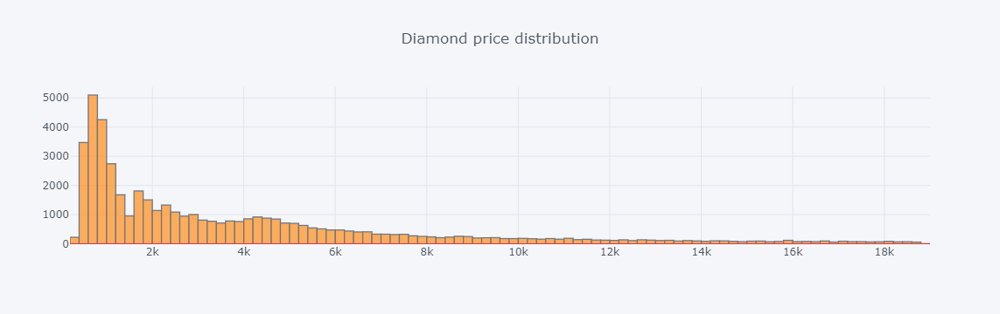

In [9]:
Train.price.iplot(kind='hist', title = 'Diamond price distribution', hline=(0))

### Continuous variables

carat:
count    48546.000000
mean         0.798418
std          0.474257
min          0.200000
25%          0.400000
50%          0.700000
75%          1.040000
max          5.010000
Name: carat, dtype: float64


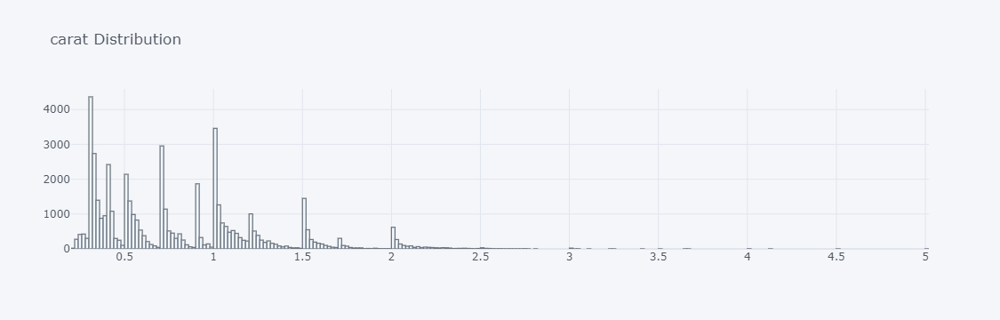

depth:
count    48546.000000
mean        61.750571
std          1.436809
min         43.000000
25%         61.000000
50%         61.800000
75%         62.500000
max         79.000000
Name: depth, dtype: float64


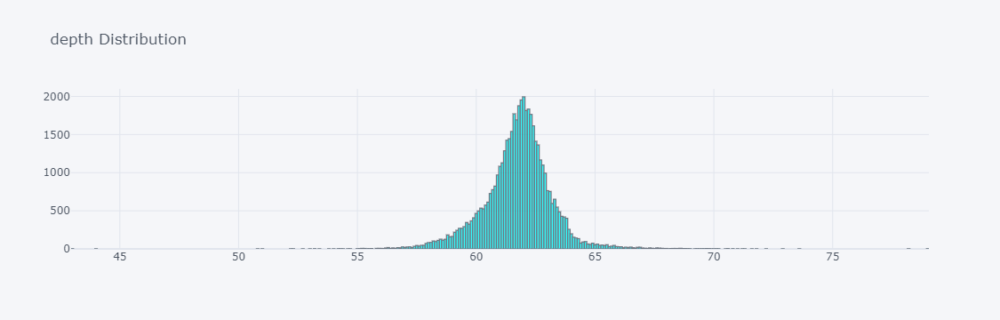

table:
count    48546.000000
mean        57.457251
std          2.236781
min         43.000000
25%         56.000000
50%         57.000000
75%         59.000000
max         95.000000
Name: table, dtype: float64


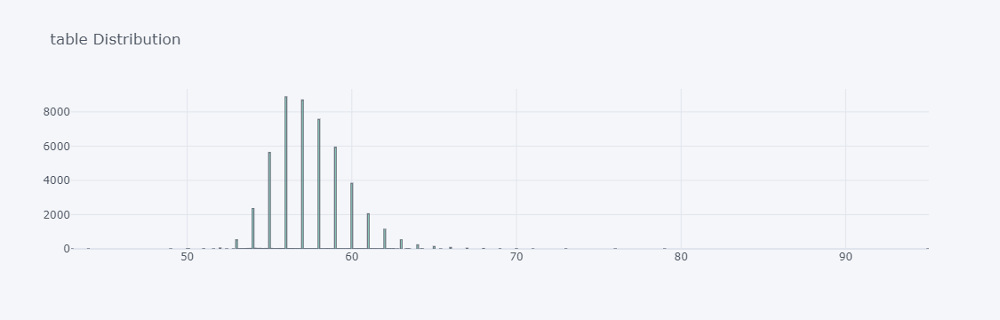

x:
count    48546.000000
mean         5.732272
std          1.121729
min          0.000000
25%          4.710000
50%          5.700000
75%          6.540000
max         10.740000
Name: x, dtype: float64


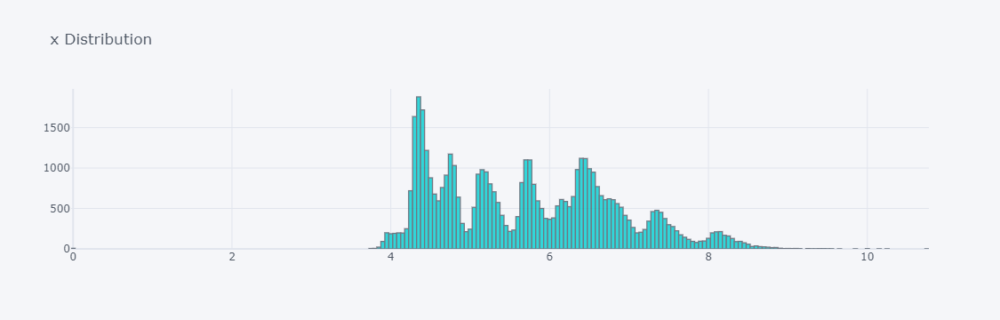

y:
count    48546.000000
mean         5.735766
std          1.145202
min          0.000000
25%          4.720000
50%          5.710000
75%          6.540000
max         58.900000
Name: y, dtype: float64


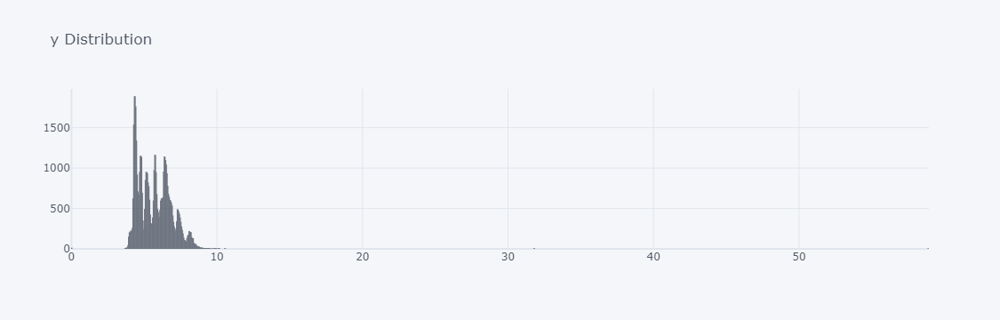

z:
count    48546.000000
mean         3.539499
std          0.707126
min          0.000000
25%          2.910000
50%          3.530000
75%          4.030000
max         31.800000
Name: z, dtype: float64


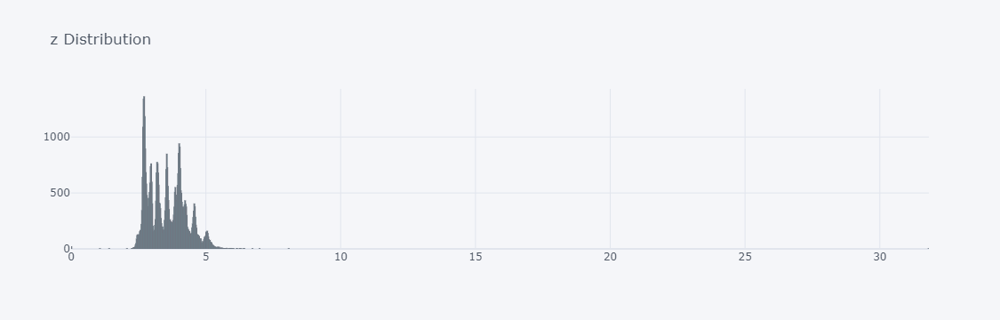

In [10]:
Continuous = Train.describe().columns.tolist()[:-1]
colors = ['aliceblue',  'aqua', 'aquamarine', 'darkturquoise','aliceblue',  'aqua']
for color,col in enumerate(Continuous):  
    print(f"{col}:\n{Train[col].describe()}")
    Train[col].iplot(kind='histogram',title = f"{col} Distribution",color = colors[color], filename='histogram-subplots')

### Categorical variables

cut (%):
Ideal        39.89
Premium      25.54
Very Good    22.40
Good          9.19
Fair          2.97
Name: cut, dtype: float64


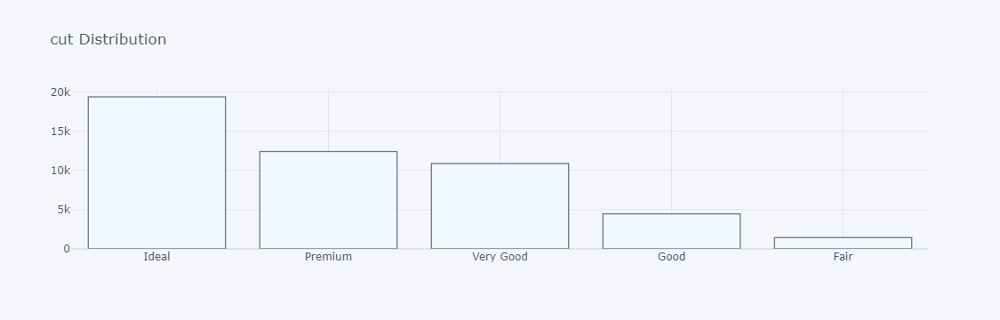

color (%):
G    20.83
E    18.20
F    17.81
H    15.35
D    12.56
I    10.08
J     5.17
Name: color, dtype: float64


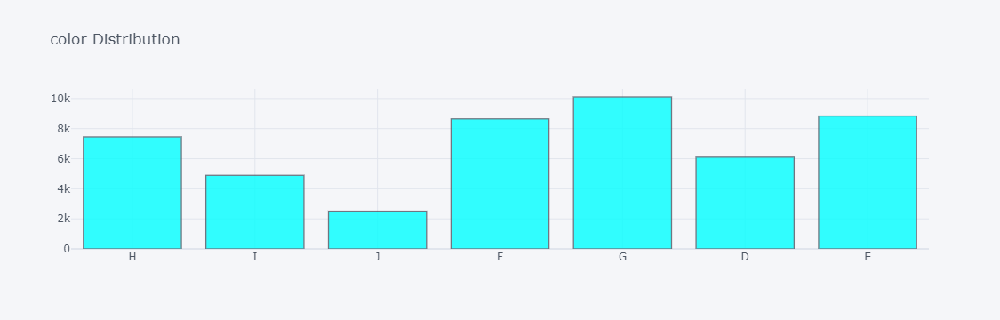

clarity (%):
SI1     24.21
VS2     22.62
SI2     17.14
VS1     15.13
VVS2     9.47
VVS1     6.72
IF       3.30
I1       1.41
Name: clarity, dtype: float64


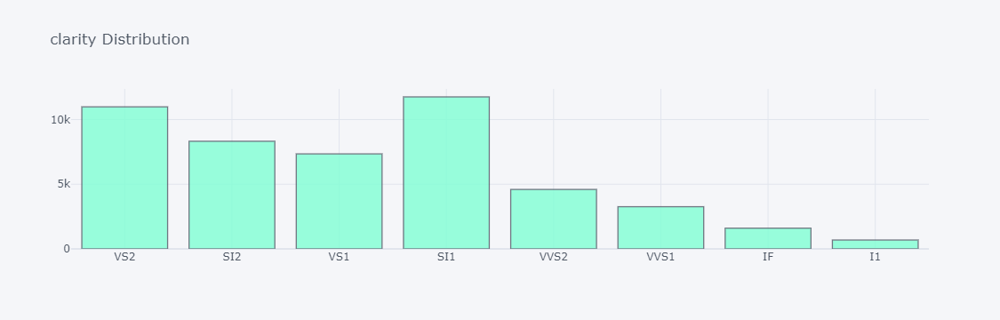

In [11]:
Cat = Train.describe(include = "object").columns.tolist()
for color,col in enumerate(Cat):  
    print(f"{col} (%):\n{round(Train[col].value_counts(normalize = True)*100,2)}")
    Train[col].iplot(kind='histogram',title = f"{col} Distribution",color = colors[color], filename='histogram-subplots')

### insights so far:
* The data is complete, no need for imputations
* There are outliers for the continuous data (mostly noticed in y and z), a boxplot will be created to see them distributesd better than in a hisogram.
* In terms of categorical variables:
    1. Colors - the 3 best colors are almost 50% of the data, the 4 remaining are the rest, most common color is G.
    2. Clarity - the best or worst clarity classes (I1 and IF) are both together less than 5% of the data middle rank clarity is most common.
    3. Cut - best quality of the cut is 40% alone, premium and ideal together are 65%, adding very good altogether is getting close to 90% of the data. 
    
## Boxplots

the boxplots gives us a wide view of the most important percetiles, let us check the target (price):

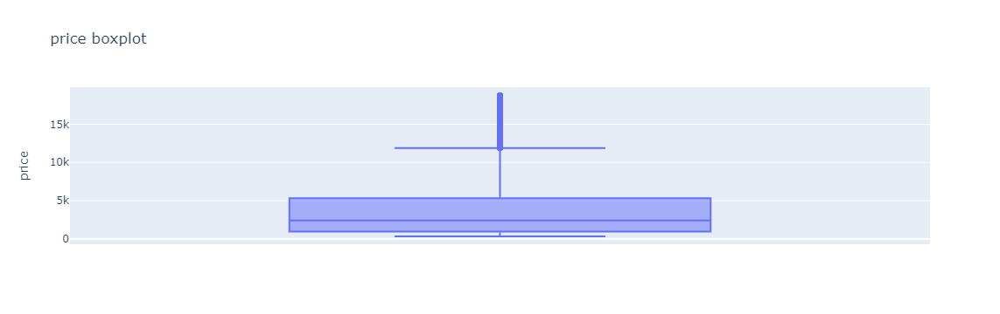

In [12]:
import plotly.express as px
fig = px.box(Train, y="price", title = "price boxplot")
fig.show()

For the rest of the continuous variables:

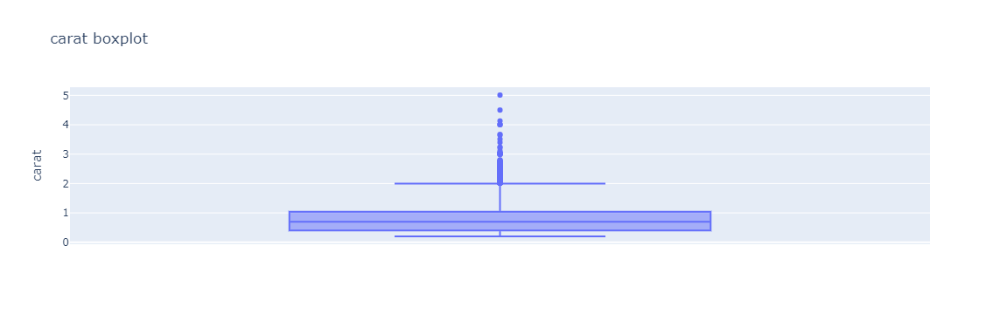

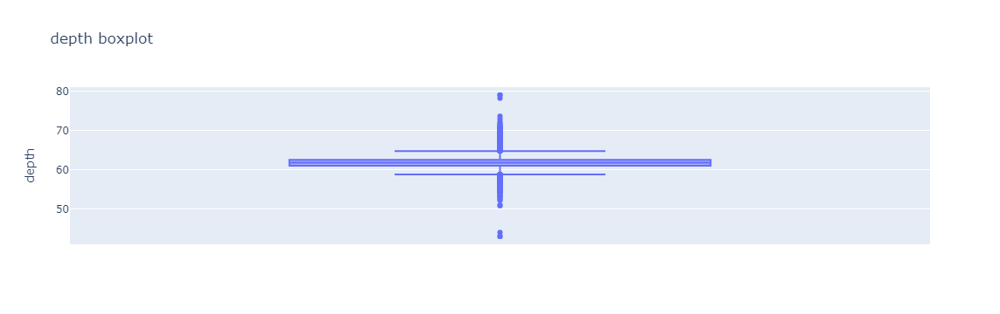

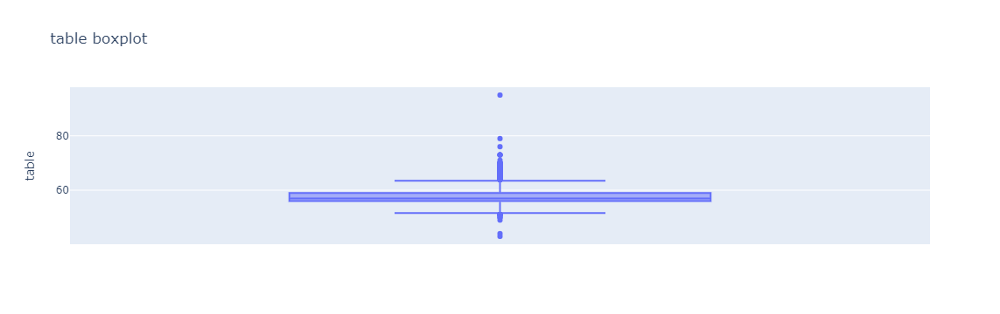

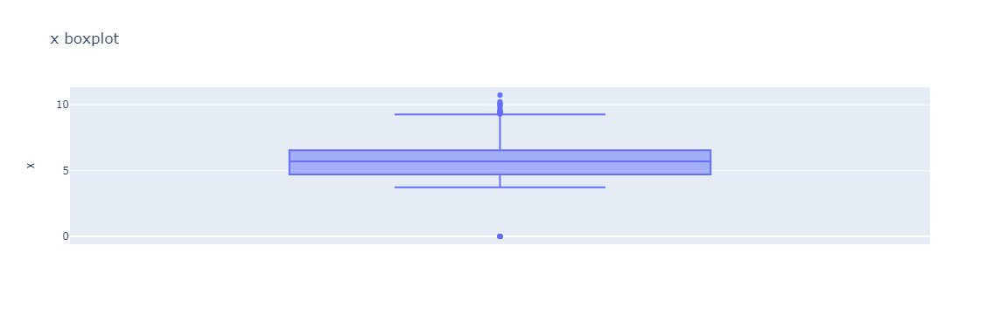

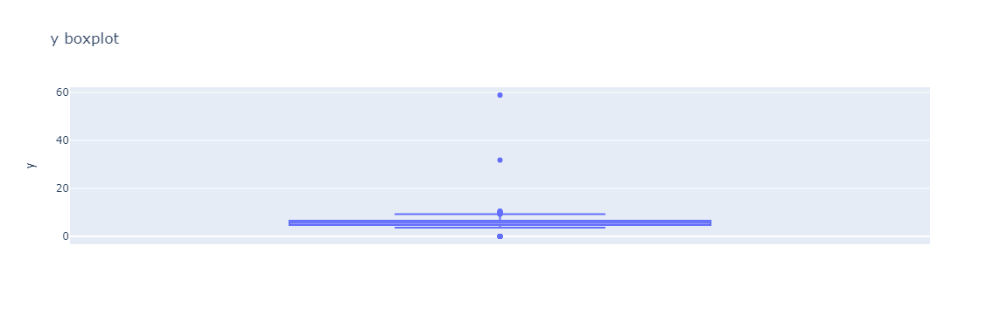

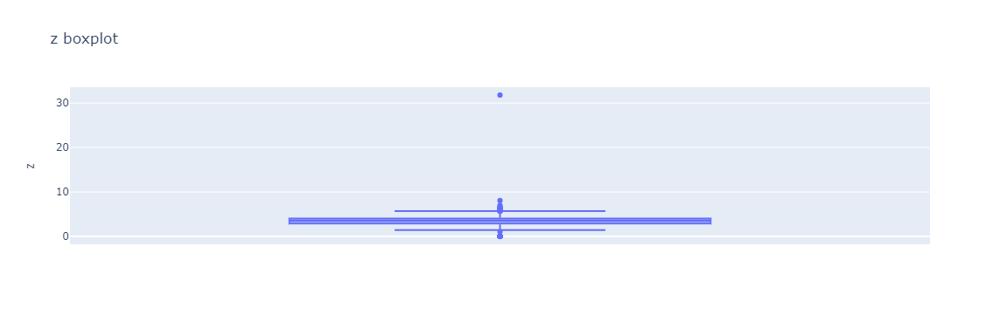

In [13]:
colors = ["blueviolet","cornflowerblue","darkcyan","darkslateblue","lavender","lavenderblush"]
for col in Continuous:
    fig = px.box(Train, y=f"{col}", title = f"{col} boxplot")
    fig.show()

**Boxplot insights:**
* **Price** - the IQR range is between 950 to 5321 dollars and a few outliers between the higher fence and the maximum value.
* **Carat** - the IQR range is between 0.4 to 1.04 and a few outliers between the higher fence and the maximum value.
* **Depth** - the IQR range is between 61 to 62.5 and outliers in both the higher and lower fences and the maximum value.
* **Table** - the IQR range is between 56 to 59 and outliers in both the higher and lower fences and the maximum value.
* **x** - the IQR range is between 4.71 to 6.54 and outliers in both the higher and lower fences and the maximum value.
* **y** - the IQR range is between 4.72 to 6.54 and outliers in both the higher and lower fences and the maximum value.
* **z** - the IQR range is between 2.91 to 4.03 and outliers in both the higher and lower fences and the maximum value.

The x,y,z columns have some wierd values like 0 that makes no sense.
This means those outliers need to be handeled. overall the data has many outlier issues.

## Distribution in relation to the target:

### Continuous:

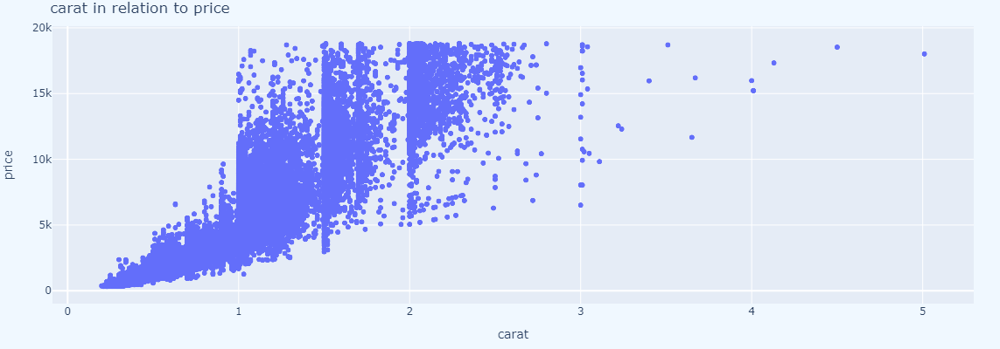

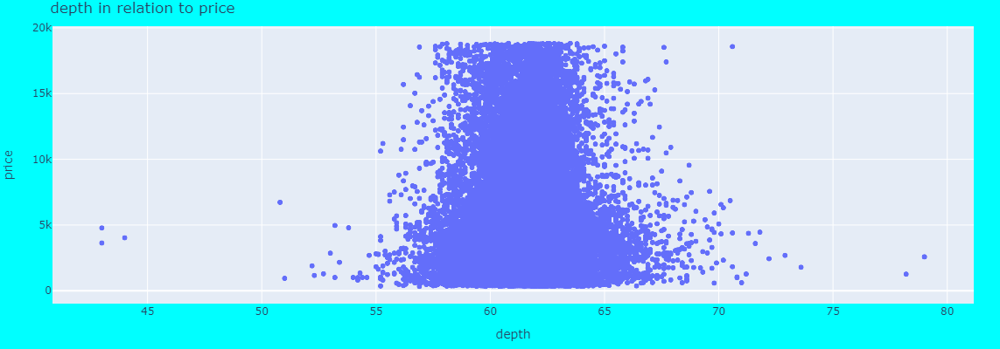

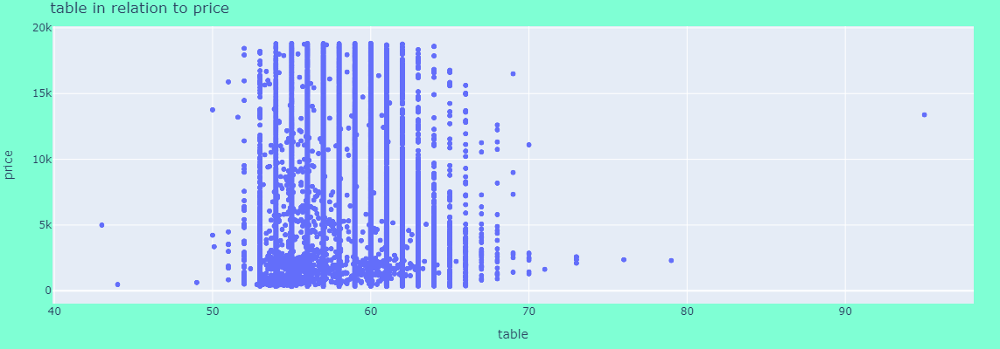

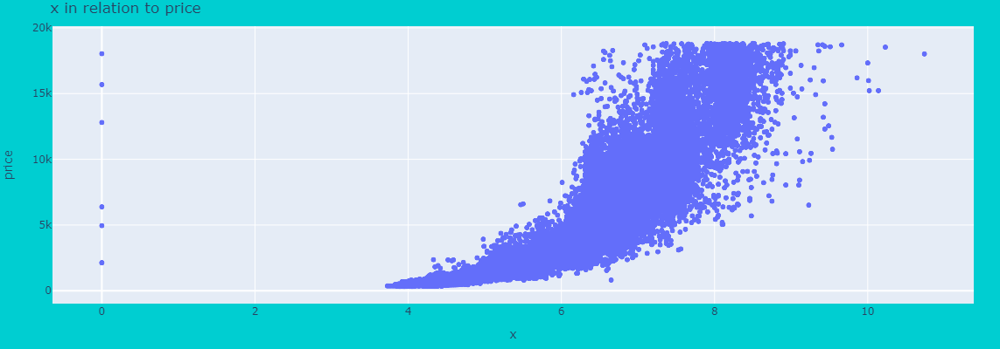

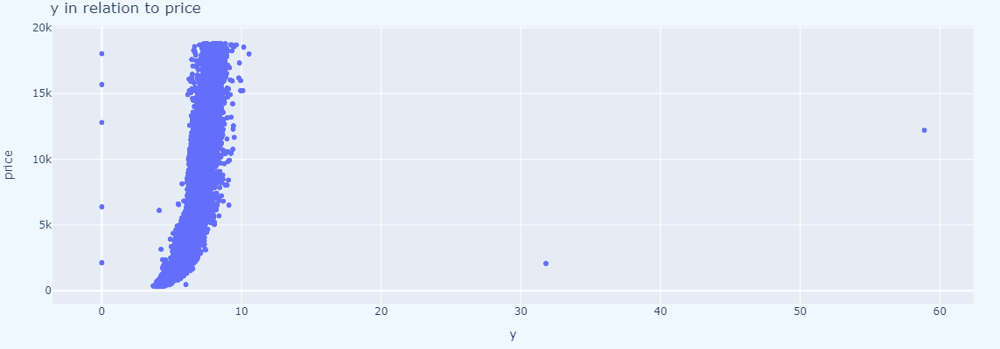

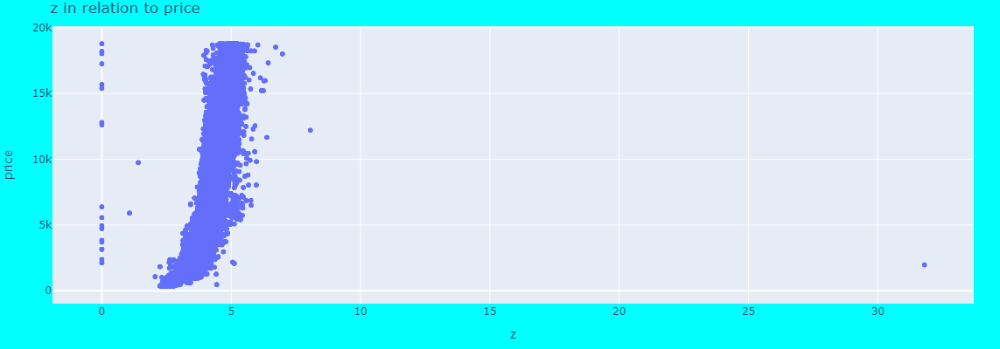

In [14]:
colors = ['aliceblue',  'aqua', 'aquamarine', 'darkturquoise','aliceblue',  'aqua']
for color,col in enumerate(Continuous):
    fig = px.scatter(Train, x=f"{col}", y="price", title = f"{col} in relation to price", width=800, height=400)
    fig.update_layout(
        margin=dict(l=30, r=30, t=30, b=30),
        paper_bgcolor=colors[color],
    )
    fig.show()

### Categorical:

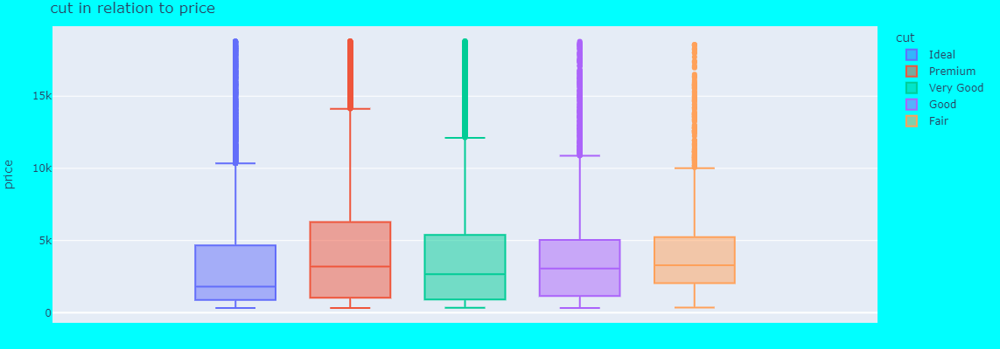

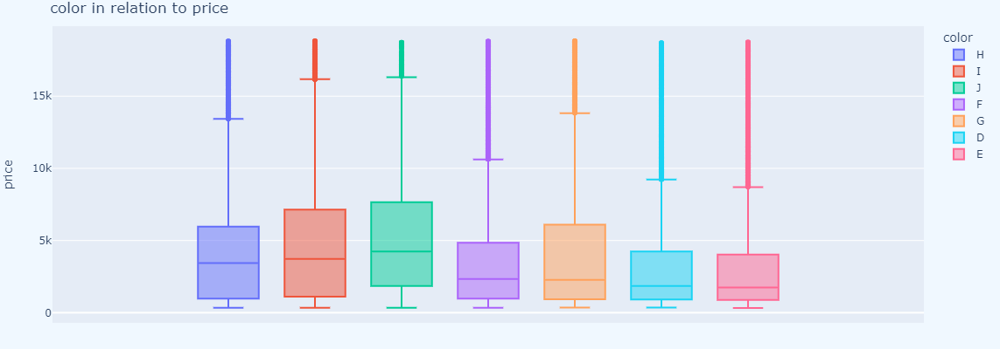

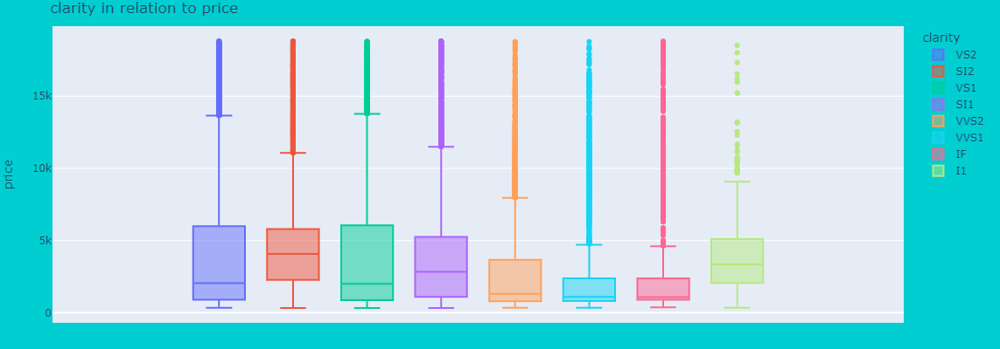

In [15]:
for color,col in enumerate(Cat):
    fig = px.box(Train, y="price",color =f"{col}"  , title = f"{col} in relation to price", width=800, height=400)
    fig.update_layout(
        margin=dict(l=30, r=30, t=30, b=30),
        paper_bgcolor=colors[::-1][color],
    )
    fig.show()

### Insights for features in relation to the price:
* **Carat** - positively correlated.
* **Depth** - it has no visible correlation.
* **Table** - it has no visible correlation.
* **x** - positively correlated.
* **y** - positively correlated.
* **z** - positively correlated.
* **cut** - premium's IQR had the highest positive correlation
* **color** - J (worst) had a better IQR in terms of price than D (best).
* **clarity** - I1 (worst) had a better IQR in terms of price than IF (best).

# Conclusion:
1. It seems outliers are a big issue need to be handled.
2. there are some data that is incorrect (height of a diamond cannot be 0), this points need to be imputed.